<a href="https://colab.research.google.com/github/meierd1809/DSC-410-Predictive-Analytics/blob/main/Exploratory_Data_Analysis_and_Model_Selection_(Regression).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import ydata_profiling as pp
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

# EDA on Bigger File

In [ ]:
eda_big_file = pd.read_csv("eda_data.csv")

In [ ]:
# Checking the count of each column along with the data type of each column

eda_big_file.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9999 entries, 0 to 9998
Data columns (total 15 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x0      9996 non-null   float64
 1   x1      9995 non-null   float64
 2   x2      9996 non-null   float64
 3   x3      9997 non-null   float64
 4   x4      9997 non-null   float64
 5   x5      9999 non-null   float64
 6   x6      9996 non-null   object 
 7   x7      9998 non-null   float64
 8   x8      9999 non-null   float64
 9   x9      9996 non-null   float64
 10  x10     9997 non-null   object 
 11  x11     9995 non-null   float64
 12  x12     9999 non-null   float64
 13  x13     9998 non-null   float64
 14  y       9999 non-null   float64
dtypes: float64(13), object(2)
memory usage: 1.1+ MB


In [ ]:
# Reviewing the first 15 rows of the data

eda_big_file.head(15)

,x0,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10,x11,x12,x13,y
0,-17.933519,6.559220,-14.452810,-4.732855,0.381673,2.563194,"($1,306.52)",-89.394348,-28.454044,-16.201298,-0.01%,0.217010,9.729891,-0.786431,0.666146
1,-37.214754,10.774930,-15.384004,-0.077339,10.983774,-15.210206,($24.86),153.032652,-32.557736,69.675903,0.00%,-3.584908,35.727926,-0.985552,0.378411
2,0.330441,-19.609972,-9.167911,2.064124,12.071688,12.506141,($110.85),-141.437276,-20.794952,55.042604,0.00%,-3.991366,-9.283523,-3.394718,0.624498
3,-13.709765,-8.011390,6.759264,1.727615,-1.768382,24.039733,($324.43),51.039653,-7.046908,-31.424419,0.01%,7.908897,-2.891882,-2.690222,0.126622
4,-4.202598,7.076210,-26.004919,-4.269696,-3.414224,2.115989,"$1,213.37",-31.046700,19.061182,-31.525515,-0.01%,0.846719,25.497480,3.516801,0.640025
5,12.570277,2.543883,25.673620,-0.842858,3.400531,37.176963,"($1,508.42)",-98.956484,11.734073,100.654890,0.00%,15.359466,9.000782,1.929145,0.875990
6,17.949374,-35.406853,-25.164967,0.587439,-13.782894,-5.204895,"($1,431.44)",-205.638274,16.399039,116.749751,0.01%,5.964466,15.851576,-0.819405,0.428533
7,38.645268,-21.871066,-74.405515,-9.707926,6.114417,-17.883435,"$1,613.55",-239.151432,28.570116,-333.261028,0.01%,5.556269,-15.112181,2.480845,0.350310
8,35.279887,-2.004483,-12.071977,-1.020028,3.250741,-19.377852,"$1,178.11",-108.229348,-29.886388,-126.434298,0.00%,4.085897,-10.558902,1.700618,0.612351
9,-31.756646,-5.499585,6.198889,-4.569550,13.902393,1.031500,($312.04),299.025699,24.338666,-25.001839,0.00%,4.204932,-5.320926,4.405564,0.494439


In [ ]:
# Removing parenthesis, dollar signs and percentages while adding in a negative sign to replace the parenthesis

eda_big_file.replace({"\(": "-", "\)": "", "\$":"", "%":"", ",":""}, regex=True, inplace=True)

In [ ]:
# Checking the changes to verify everything functioned how it should have

eda_big_file.head(15)

,x0,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10,x11,x12,x13,y
0,-17.933519,6.559220,-14.452810,-4.732855,0.381673,2.563194,-1306.52,-89.394348,-28.454044,-16.201298,-0.01,0.217010,9.729891,-0.786431,0.666146
1,-37.214754,10.774930,-15.384004,-0.077339,10.983774,-15.210206,-24.86,153.032652,-32.557736,69.675903,0.00,-3.584908,35.727926,-0.985552,0.378411
2,0.330441,-19.609972,-9.167911,2.064124,12.071688,12.506141,-110.85,-141.437276,-20.794952,55.042604,0.00,-3.991366,-9.283523,-3.394718,0.624498
3,-13.709765,-8.011390,6.759264,1.727615,-1.768382,24.039733,-324.43,51.039653,-7.046908,-31.424419,0.01,7.908897,-2.891882,-2.690222,0.126622
4,-4.202598,7.076210,-26.004919,-4.269696,-3.414224,2.115989,1213.37,-31.046700,19.061182,-31.525515,-0.01,0.846719,25.497480,3.516801,0.640025
5,12.570277,2.543883,25.673620,-0.842858,3.400531,37.176963,-1508.42,-98.956484,11.734073,100.654890,0.00,15.359466,9.000782,1.929145,0.875990
6,17.949374,-35.406853,-25.164967,0.587439,-13.782894,-5.204895,-1431.44,-205.638274,16.399039,116.749751,0.01,5.964466,15.851576,-0.819405,0.428533
7,38.645268,-21.871066,-74.405515,-9.707926,6.114417,-17.883435,1613.55,-239.151432,28.570116,-333.261028,0.01,5.556269,-15.112181,2.480845,0.350310
8,35.279887,-2.004483,-12.071977,-1.020028,3.250741,-19.377852,1178.11,-108.229348,-29.886388,-126.434298,0.00,4.085897,-10.558902,1.700618,0.612351
9,-31.756646,-5.499585,6.198889,-4.569550,13.902393,1.031500,-312.04,299.025699,24.338666,-25.001839,0.00,4.204932,-5.320926,4.405564,0.494439


In [ ]:
# Based on the original eda_big_file.info() code run, column x6 and x10 were objects and need to be converted to floats,
# Which is what this line of code is doing

eda_big_file[["x6", "x10"]] = eda_big_file[["x6", "x10"]].astype(float)

In [ ]:
# Rechecking the datatypes of each column

eda_big_file.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9999 entries, 0 to 9998
Data columns (total 15 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x0      9996 non-null   float64
 1   x1      9995 non-null   float64
 2   x2      9996 non-null   float64
 3   x3      9997 non-null   float64
 4   x4      9997 non-null   float64
 5   x5      9999 non-null   float64
 6   x6      9996 non-null   float64
 7   x7      9998 non-null   float64
 8   x8      9999 non-null   float64
 9   x9      9996 non-null   float64
 10  x10     9997 non-null   float64
 11  x11     9995 non-null   float64
 12  x12     9999 non-null   float64
 13  x13     9998 non-null   float64
 14  y       9999 non-null   float64
dtypes: float64(15)
memory usage: 1.1 MB


In [ ]:
# Dropping all of the rows that have missing values due to the small amount of values missing compared to the overall
# Quantity of data in the file

eda_big_file = eda_big_file.dropna()

In [ ]:
# Rechecking the counts of the data to make sure they match

eda_big_file.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9971 entries, 0 to 9998
Data columns (total 15 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   x0      9971 non-null   float64
 1   x1      9971 non-null   float64
 2   x2      9971 non-null   float64
 3   x3      9971 non-null   float64
 4   x4      9971 non-null   float64
 5   x5      9971 non-null   float64
 6   x6      9971 non-null   float64
 7   x7      9971 non-null   float64
 8   x8      9971 non-null   float64
 9   x9      9971 non-null   float64
 10  x10     9971 non-null   float64
 11  x11     9971 non-null   float64
 12  x12     9971 non-null   float64
 13  x13     9971 non-null   float64
 14  y       9971 non-null   float64
dtypes: float64(15)
memory usage: 1.2 MB


In [ ]:
# Running descriptive statistics on the dataset after cleaning

eda_big_file.describe()

,x0,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10,x11,x12,x13,y
count,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000,9971.000000
mean,6.513610,-3.725096,-7.355218,-0.004795,1.358905,1.218373,-3.262413,-4.271346,-0.308685,-22.454140,-0.000047,0.033541,-0.235061,-0.430561,0.496801
std,29.138624,17.234251,38.348738,3.995019,9.606422,17.362779,999.977471,131.944425,38.007005,91.764225,0.010409,6.062640,14.667768,2.825054,0.288513
min,-106.809919,-65.137848,-150.846091,-14.616540,-37.499530,-59.900503,-4496.460000,-661.764937,-142.719688,-427.412374,-0.040000,-25.024464,-57.315771,-12.527505,0.000193
25%,-13.076152,-15.351276,-33.082217,-2.683281,-5.036260,-10.904697,-668.555000,-91.582465,-25.710854,-79.686288,-0.010000,-4.191568,-10.312554,-2.345466,0.243654
50%,6.644443,-3.825630,-7.379171,0.007496,1.229702,0.814554,9.880000,-4.752753,-0.240048,-20.431088,0.000000,0.151308,-0.643502,-0.415093,0.493860
75%,26.222540,7.764036,18.452622,2.630834,7.815508,12.704898,676.095000,83.824151,25.451886,38.471067,0.010000,4.133541,9.483323,1.448132,0.746733
max,114.823451,67.685933,127.204103,16.923269,38.624213,68.865261,3701.060000,476.910533,181.063340,319.592518,0.040000,21.540626,57.918619,8.987513,0.999954


In [ ]:
# Checking the correlation between variables in the data set

eda_corr = eda_big_file.corr()
eda_corr

,x0,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10,x11,x12,x13,y
x0,1.000000,-0.219089,-0.148118,0.001206,-0.190507,-0.037805,0.206673,-0.363096,0.087802,-0.116054,-0.217697,-0.001692,-0.125518,-0.058904,-0.005003
x1,-0.219089,1.000000,-0.025998,0.003471,-0.115866,0.145211,0.006001,-0.216942,0.077929,0.070233,-0.004398,0.003117,0.144039,0.101268,-0.006417
x2,-0.148118,-0.025998,1.000000,0.015836,-0.151388,0.122244,-0.026261,0.131243,0.025392,0.075771,0.080456,0.002057,-0.183939,0.079088,0.005342
x3,0.001206,0.003471,0.015836,1.000000,-0.004844,-0.000925,0.001211,-0.015895,-0.022814,0.002495,-0.026216,0.007274,0.005443,0.005004,-0.003464
x4,-0.190507,-0.115866,-0.151388,-0.004844,1.000000,-0.038751,-0.031628,0.059356,-0.093900,-0.097659,-0.010724,0.002751,0.122459,-0.030100,0.000065
x5,-0.037805,0.145211,0.122244,-0.000925,-0.038751,1.000000,-0.094843,-0.089785,0.109687,-0.186343,0.041861,0.004299,-0.019245,0.127726,0.010734
x6,0.206673,0.006001,-0.026261,0.001211,-0.031628,-0.094843,1.000000,-0.255834,0.020850,-0.422103,0.016555,0.012700,0.038784,-0.011384,-0.011474
x7,-0.363096,-0.216942,0.131243,-0.015895,0.059356,-0.089785,-0.255834,1.000000,0.062167,0.087021,0.165425,-0.011266,0.000457,0.148212,-0.004720
x8,0.087802,0.077929,0.025392,-0.022814,-0.093900,0.109687,0.020850,0.062167,1.000000,-0.014487,0.165492,-0.006709,-0.144617,0.037757,0.000444
x9,-0.116054,0.070233,0.075771,0.002495,-0.097659,-0.186343,-0.422103,0.087021,-0.014487,1.000000,0.087001,0.007080,0.054607,-0.323656,0.019845


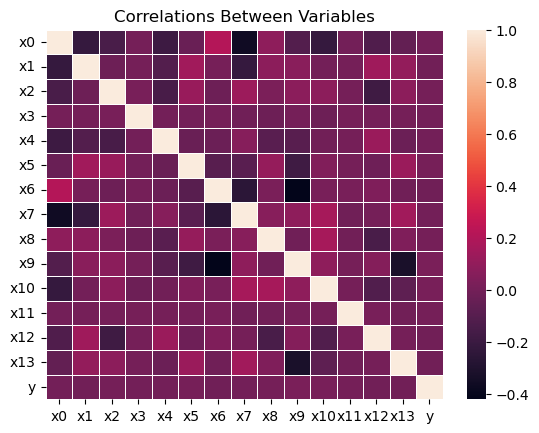

In [ ]:
#Plotting a heat map as an additional visualization of the correlation between variables

ax = sns.heatmap(eda_corr, linewidth=0.5)
ax.set_title("Correlations Between Variables")
plt.show()

C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

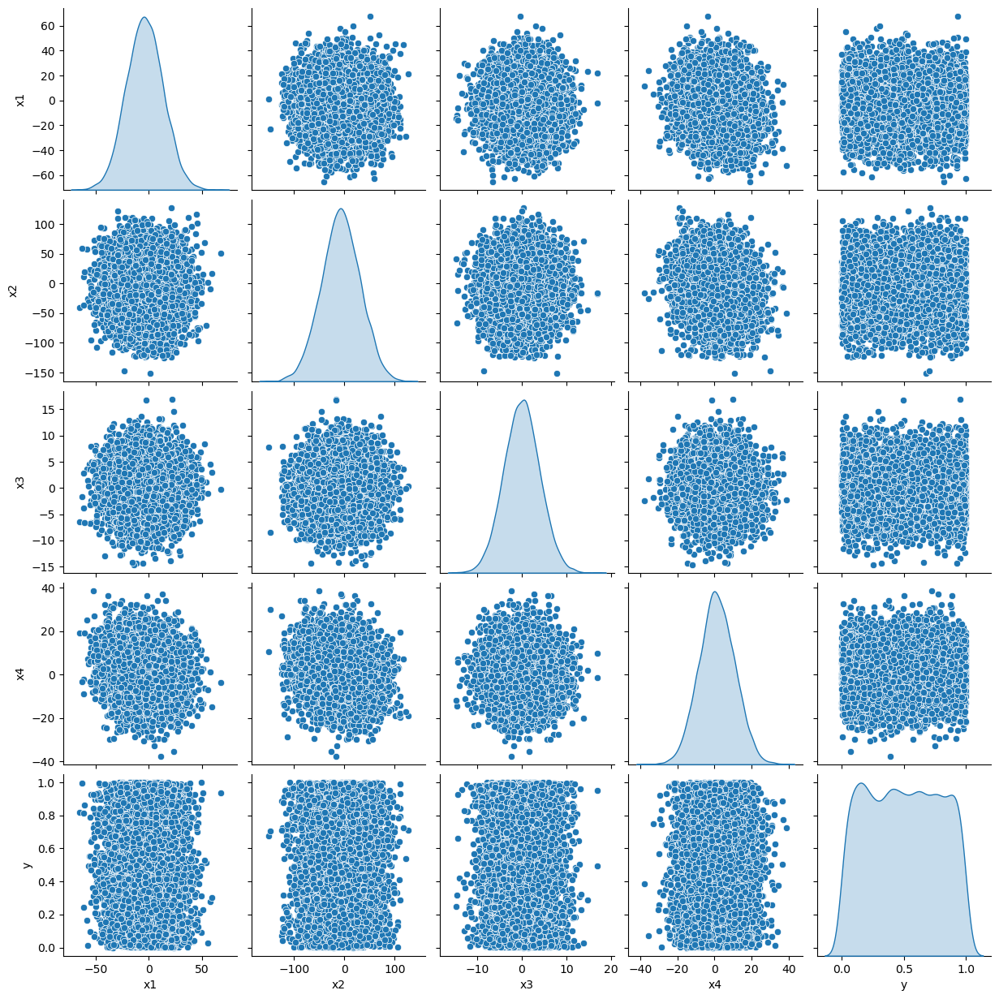

In [ ]:
#This is an example of breaking down EDA to evaluate smaller sets of the data
#Trying to do a pairplot on the entire data at once is unreadable

eda_big_file_partial = eda_big_file[["x1", 'x2', 'x3', 'x4', 'y']]
sns.pairplot(eda_big_file_partial, diag_kind = 'kde');

C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

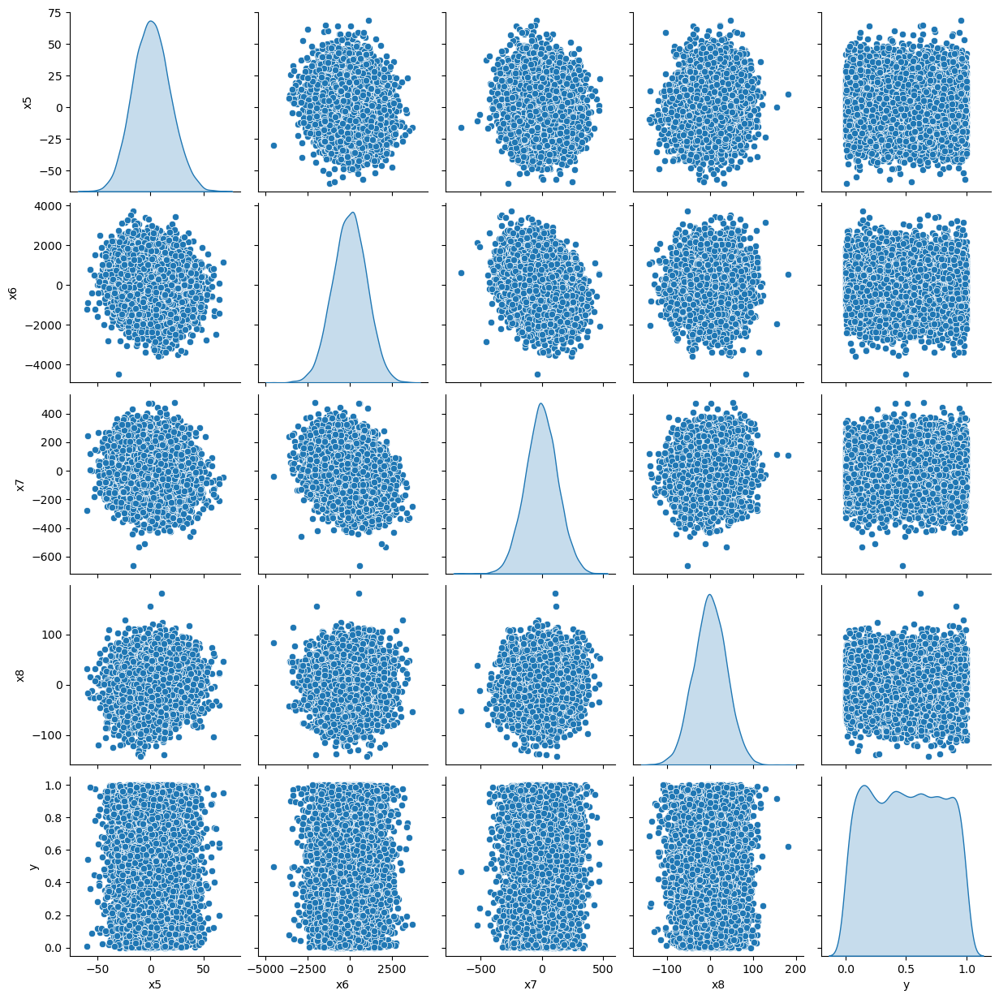

In [ ]:
eda_big_file_partial2 = eda_big_file[["x5", 'x6', 'x7', 'x8', 'y']]
sns.pairplot(eda_big_file_partial2, diag_kind = 'kde');

C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\meier\.ms-ad\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

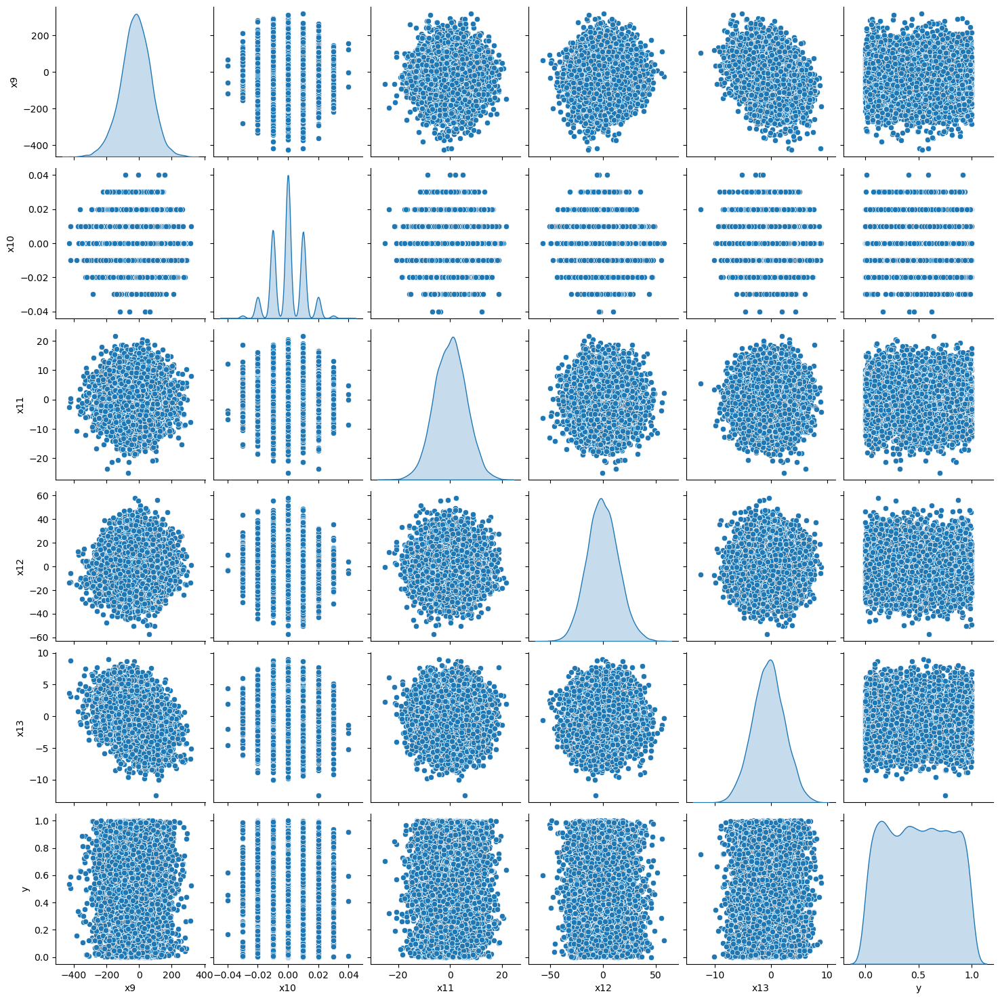

In [ ]:
eda_big_file_partial3 = eda_big_file[["x9", 'x10', 'x11', 'x12', 'x13', 'y']]
sns.pairplot(eda_big_file_partial3, diag_kind = 'kde');

# Pandas Profiling on Smaller File

In [ ]:
eda_small_file = pd.read_csv("eda_data_small.csv")

In [ ]:
eda_small_file.head(15)

,x0,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10,x11,x12,x13,y
0,-17.933519,6.559220,-14.452810,-4.732855,0.381673,2.563194,"($1,306.52)",-89.394348,-28.454044,-16.201298,-0.01%,0.217010,9.729891,-0.786431,0.666146
1,-37.214754,10.774930,-15.384004,-0.077339,10.983774,-15.210206,($24.86),153.032652,-32.557736,69.675903,0.00%,-3.584908,35.727926,-0.985552,0.378411
2,0.330441,-19.609972,-9.167911,2.064124,12.071688,12.506141,($110.85),-141.437276,-20.794952,55.042604,0.00%,-3.991366,-9.283523,-3.394718,0.624498
3,-13.709765,-8.011390,6.759264,1.727615,-1.768382,24.039733,($324.43),51.039653,-7.046908,-31.424419,0.01%,7.908897,-2.891882,-2.690222,0.126622
4,-4.202598,7.076210,-26.004919,-4.269696,-3.414224,2.115989,"$1,213.37",-31.046700,19.061182,-31.525515,-0.01%,0.846719,25.497480,3.516801,0.640025
5,12.570277,2.543883,25.673620,-0.842858,3.400531,37.176963,"($1,508.42)",-98.956484,11.734073,100.654890,0.00%,15.359466,9.000782,1.929145,0.875990
6,17.949374,-35.406853,-25.164967,0.587439,-13.782894,-5.204895,"($1,431.44)",-205.638274,16.399039,116.749751,0.01%,5.964466,15.851576,-0.819405,0.428533
7,38.645268,-21.871066,-74.405515,-9.707926,6.114417,-17.883435,"$1,613.55",-239.151432,28.570116,-333.261028,0.01%,5.556269,-15.112181,2.480845,0.350310
8,35.279887,-2.004483,-12.071977,-1.020028,3.250741,-19.377852,"$1,178.11",-108.229348,-29.886388,-126.434298,0.00%,4.085897,-10.558902,1.700618,0.612351
9,-31.756646,-5.499585,6.198889,-4.569550,13.902393,1.031500,($312.04),299.025699,24.338666,-25.001839,0.00%,4.204932,-5.320926,4.405564,0.494439


In [ ]:
pp.ProfileReport(eda_small_file)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Pandas profiling returns some very detailed information on the data. Expecting each column to be numerical values, Pandas profiling returns text for both x6 and x10 as datatypes, indicating that those columns need some exploring further to clean. This also returns the count of missing values which helps us to not only understand the totality of missing cells, but which columns this data is missing from. it also returns some descriptive statistics on the columns as well (mean, min, max) which is also helpful to glean some initial information from.

# Selecting Model

### Each feature, including the target variable, are numerical and continuous, so I am going to use a Linear Regression Model.

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

In [ ]:
# Making all of the "x" columns the features, and setting the "y" column as the target

X = eda_big_file.drop(['y'], axis=1)
y = eda_big_file[['y']]

# This is setting up the training and testing data. It will use 80% of the data to train, and 20% to test
# Random state means that this model will run with the same set of data each time the program is run

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [ ]:
# Setting up an instance of the LinearRegression model, fitting it with the training data which means it is adjusting
# the parameters to optimize the match between the test values and predicted values, and then using the trained model
# to create predictions off of the test data

lr_regressor = LinearRegression()

lr_regressor.fit(X_train, y_train)

y_pred = lr_regressor.predict(X_test)

In [ ]:
# Printing out the r2 score of the model

r2 = r2_score(y_test, y_pred)

print(f"R2 of this model is: {r2:.4f}")
print()

R2 of this model is: -0.0013



Since the R2 value is nearly 0, this means that using all of the feature data (all of the x columns) to input into the Linear Regression model essentially is saying that almost 0% of the variability in y can be explained using X. This would mean that we would need to do more exploration at tuning the model in order to find the best path forward to improve the model as much as possible.